In [1]:
import numpy
from stl import mesh

In [2]:
# Using an existing stl file:
my_mesh = mesh.Mesh.from_file('fatyoshi.stl')
print(my_mesh)

<Mesh: b'COLOR=\x7f\x7f\x7f MATERIAL=\x7f\x7f\x7f \x7f\x7f\x7f \x7f\x7f\x7f' 599888 vertices>


In [3]:
print("Normals =", my_mesh.normals)

print("Some Mesh Vectors =", my_mesh.vectors)

Normals = [[-2.61751413e-01 -1.60645187e-01 -1.99653208e-04]
 [ 1.96604848e-01 -1.25173762e-01  2.37873718e-02]
 [ 1.40321612e-01 -7.08354637e-02 -3.28980163e-02]
 ...
 [ 8.58451128e-02 -1.47392228e-01 -6.88037872e-02]
 [ 7.23771304e-02 -2.19629630e-02 -5.82706891e-02]
 [ 1.02519356e-01 -2.98422668e-02 -7.84111470e-02]]
Some Mesh Vectors = [[[25.035896 63.03459  70.36275 ]
  [25.36736  62.4938   70.93636 ]
  [25.117268 62.90123  70.98822 ]]

 [[75.151474 62.448814 74.32079 ]
  [74.94877  62.08803  74.097664]
  [75.05993  62.16853  73.60251 ]]

 [[68.21594  68.42759  82.17688 ]
  [68.00422  68.223946 81.71229 ]
  [68.151215 68.52071  81.70028 ]]

 ...

 [[62.408268 53.795784 59.01751 ]
  [61.89097  53.646584 58.691704]
  [62.103027 53.84075  58.540337]]

 [[80.88017  41.846638 74.99146 ]
  [81.171776 41.898613 75.33407 ]
  [81.16043  41.696762 75.39606 ]]

 [[81.16043  41.696762 75.39606 ]
  [81.171776 41.898613 75.33407 ]
  [81.55084  41.73147  75.893295]]]


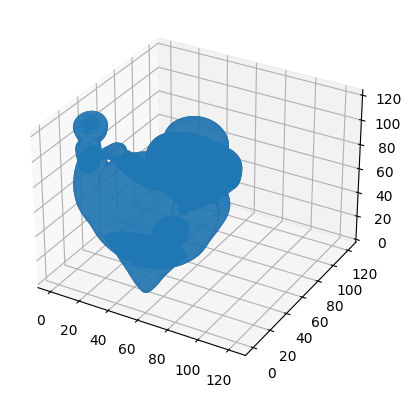

In [4]:
from mpl_toolkits import mplot3d
from matplotlib import pyplot

%matplotlib

# Create a new plot
figure = pyplot.figure()
axes = figure.add_subplot(projection='3d')

# Load the STL files and add the vectors to the plot
my_mesh = mesh.Mesh.from_file('fatyoshi.stl')
axes.add_collection3d(mplot3d.art3d.Poly3DCollection(my_mesh.vectors))

# Auto scale to the mesh size
scale = my_mesh.points.flatten()
axes.auto_scale_xyz(scale, scale, scale)

# Show the plot to the screen
pyplot.show()

In [5]:
print("Points =", my_mesh.points.reshape([-1,3]))

Points = [[25.035896 63.03459  70.36275 ]
 [25.36736  62.4938   70.93636 ]
 [25.117268 62.90123  70.98822 ]
 ...
 [81.16043  41.696762 75.39606 ]
 [81.171776 41.898613 75.33407 ]
 [81.55084  41.73147  75.893295]]


Creating a Half Edge Structure

In [9]:
class HalfEdge:
    def __init__(self, start, end, twin=None, next=None):
        self.start = start
        self.end = end
        self.twin = twin
        self.next = next

def parse_stl(filename):
    # Load the STL file into a numpy array
    stl_mesh = mesh.Mesh.from_file("fatyoshi.stl")
    # Get the number of faces
    num_faces = stl_mesh.vectors.shape[0]
    # Get the vertices of each face
    vertices = stl_mesh.vectors
    # Create a list to store the half-edges
    halfedges = []
    # Iterate over the faces
    for i in range(num_faces):
        face = vertices[i]
        # Get the start and end vertices of the first half-edge
        start, end = face[0], face[1]
        # Create the first half-edge
        halfedge = HalfEdge(start, end)
        # Set the next half-edge to be the second half-edge
        halfedge.next = HalfEdge(end, face[2], next=halfedge)
        # Set the twin half-edge to be the third half-edge
        halfedge.next.next = HalfEdge(face[2], start, twin=halfedge)
        # Add the first half-edge to the list
        halfedges.append(halfedge)
    return halfedges

if __name__ == '__main__':
    # Example usage
    halfedges = parse_stl('teapot.stl')
    print('Half-edges:')
    count=0
    for halfedge in halfedges:
        print(halfedge.start, halfedge.end)
        count+=1
    print (f"Number of halfedges: {count}")

Half-edges:
[25.035896 63.03459  70.36275 ] [25.36736 62.4938  70.93636]
[75.151474 62.448814 74.32079 ] [74.94877  62.08803  74.097664]
[68.21594 68.42759 82.17688] [68.00422  68.223946 81.71229 ]
[39.38755 60.32483 90.15465] [39.961548 59.990364 90.379616]
[22.917183 68.605225 81.268005] [22.855465 68.0053   80.90839 ]
[26.596588 63.258266 66.207855] [26.814358 63.16708  66.41194 ]
[79.900024 66.847435 71.70723 ] [79.822876 66.53244  71.852585]
[73.87239 60.4679  71.75652] [73.72954 60.3096  72.37205]
[38.469078 23.485924 37.63202 ] [38.206184 23.107399 37.720573]
[33.30945  18.491352 25.20359 ] [34.13884  18.058048 23.789352]
[49.737213 90.87039  68.79632 ] [50.1855  90.99021 68.66583]
[50.734787 95.29239  67.66644 ] [50.657974 95.27546  67.369606]
[49.754707 94.83286  70.00657 ] [49.727318 94.32067  69.971054]
[ 48.452423 100.368935  66.68118 ] [ 48.566124 100.1438    66.49372 ]
[44.488396 94.25581  64.46652 ] [44.24782  94.157814 64.60133 ]
[42.224678 88.209236 68.31475 ] [42.2749